In [20]:
import pickle
import os
import pandas as pd
from PIL import Image
import numpy as np
import matplotlib.pyplot as plt
import geopandas as gpd
from shapely.geometry import Point, LineString
import random 
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans, MiniBatchKMeans
from sklearn.metrics import silhouette_score
from sklearn.metrics.pairwise import cosine_similarity
from scipy.stats import ttest_ind
import hdbscan
from itertools import combinations
import umap
import seaborn as sns

from functions import *

In [2]:
data_dir = os.path.join("../../data/embeddings/")
lsoas_file = os.path.join("../../data/SpatialData/", "LSOAs_2021", "LSOA_2021_EW_BSC_V4.shp")

### IMD data

In [ ]:
imd_file = os.path.join("../../", "data", "imd", "File_2_-_IoD2025_Domains_of_Deprivation.xlsx")
imd = pd.read_excel(imd_file, sheet_name="IoD2025 Domains", header=0)

# Rename columns to simpler versions
imd_col_map = {"LSOA code (2021)": "LSOA21CD",
    "Index of Multiple Deprivation (IMD) Rank (where 1 is most deprived)": "imd_rank",
    "Index of Multiple Deprivation (IMD) Decile (where 1 is most deprived 10% of LSOAs)": "imd_decile"}
imd = imd.rename(columns=imd_col_map)

## Spatial data
### Get LSOAs spatial data, keep just those in Greater Manchester

In [72]:
lsoas =  gpd.read_file(lsoas_file)
manc_lads = ['Manchester', 'Rochdale', 'Bolton', 'Bury', 'Wigan', 'Oldham',  'Trafford', 'Salford', 'Tameside', 'Stockport']
manc_lads_pattern = '|'.join(manc_lads)
gm_lsoa=lsoas[lsoas['LSOA21NM'].str.contains(manc_lads_pattern)].copy()

In [74]:
# Define Manchester city centre point (in WGS84, then project)
city_centre_wgs84 = Point(-2.2426, 53.4808)  # approx lat/lon of Manchester city centre
city_centre_point = gpd.GeoSeries([city_centre_wgs84], crs='EPSG:4326').to_crs(epsg=27700).iloc[0]

# Filter polygons within a buffer distance (e.g., 3 km radius)
buffer = city_centre_point.buffer(6000)  # 3000 meters
central_lsoas = gm_lsoa[gm_lsoa.intersects(buffer)]
central_lsoas.reset_index(inplace=True)
central_lsoas= central_lsoas.to_crs(epsg=4326)

### Find distance between centre of each LSOA and the middle of Manchester

In [70]:
# Reference point (Manchester city centre) in WGS84
ref_point = gpd.GeoSeries([Point(-2.2425, 53.480833)], crs="EPSG:4326")

# Project the reference point too
ref_point_metric = ref_point.to_crs(epsg=27700).iloc[0]

# Calculate distance from centroid of each LSOA to reference point
gm_lsoa["distance_to_centre_m"] = gm_lsoa.geometry.centroid.distance(ref_point_metric)

# gm_lsoa = gm_lsoa.to_crs(epsg=4326)

## Embeddings 
### Get embeddings (four per location)

In [5]:
points_data_cache = data_dir + "sample_points_cache/points_data_cache_with_embeddings_and_attn_stats_new.pkl"
with open(points_data_cache, "rb") as f:
    point_records = pickle.load(f)

### Join image embeddings points to gentrification LSOAs

In [6]:
point_coords = [Point(rec['longitude'], rec['latitude']) for rec in point_records]
points_labels_gdf = gpd.GeoDataFrame(point_records, geometry=point_coords, crs="EPSG:4326")

# Perform spatial join to get gentrification label for each point
points_labels_gdf = gpd.sjoin(points_labels_gdf, gm_lsoa, how='inner', predicate='within')
# sjoin may add an index from the polygon ('index_right'); we can drop it
if 'index_right' in points_labels_gdf.columns:
    points_labels_gdf = points_labels_gdf.drop(columns=['index_right'])

print(f"Points after spatial join: {len(points_labels_gdf)} / {len(point_records)}"
      f" `(some points may lie outside the label polygons and were dropped)")

Points after spatial join: 18897 / 18897 `(some points may lie outside the label polygons and were dropped)


### Expand so there is one row per each image

In [185]:
expanded_rows = []

for _, row in points_labels_gdf.iterrows():
    embeddings = row['embeddings']      # list of 4 embeddings
    images = row['image_files']        # list of 4 image paths

    # Skip if lengths don't match
    if len(embeddings) != len(images):
        print(f"Skipping row {row.name}: {len(embeddings)} embeddings, {len(images)} images")
        continue

    for emb, img in zip(embeddings, images):
        new_row = row.to_dict()        # copy all other columns
        new_row['embeddings'] = emb     # single embedding
        new_row['image_files'] = img    # single image
        expanded_rows.append(new_row)

# Create new DataFrame
expanded_gdf = pd.DataFrame(expanded_rows)
print(f"Original rows: {len(points_labels_gdf)}, Expanded rows: {len(expanded_gdf)}")
expanded_gdf = pd.DataFrame(expanded_rows)


Skipping row 9158: 3 embeddings, 4 images
Skipping row 12091: 3 embeddings, 4 images
Skipping row 18664: 3 embeddings, 4 images
Original rows: 18897, Expanded rows: 75576


## Kmeans cluster analysis
### Run cluster analysis on reduced embeddings

In [186]:
all_embeddings = np.stack(expanded_gdf['embeddings'].values)

In [182]:
from sklearn.ensemble import IsolationForest

# 1. HDBSCAN outlier scores
clusterer = hdbscan.HDBSCAN(
    min_cluster_size=50,
    min_samples=5,
    metric='euclidean'
).fit(X)
scores = clusterer.outlier_scores_  # higher = more outlier

scores = clusterer.outlier_scores_
hdb_outliers = scores > np.percentile(scores, 99)

# 2. Isolation Forest
iso = IsolationForest(contamination=0.01).fit(X)
iso_outliers = iso.predict(X) == -1

# 3. Combined decision
final_outliers = np.where(hdb_outliers & iso_outliers)[0]


'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


In [176]:
# from sklearn.neighbors import NearestNeighbors

# X=all_embeddings
# nbrs = NearestNeighbors(n_neighbors=10, metric="euclidean").fit(X)
# distances, _ = nbrs.kneighbors(X)

# knn_scores = distances[:, -1]  # distance to 10th neighbour

outliers = np.argsort(knn_scores)[-500:]  # top 500 unusual images


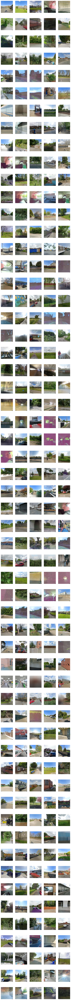

In [184]:
n_images=len(final_outliers)
n_cols = 5
n_rows=int(n_images/n_cols)
fig,axs=plt.subplots(n_rows, n_cols, figsize=(10,int(n_images/2)))
axs=axs.flatten()
for ax_num, n in enumerate(final_outliers):
    img_path = expanded_gdf['image_files'][n]
    adj_path = img_path.replace("airbnb-manchester/", "embeddings/").replace("../", "../../")
    img = plt.imread(adj_path)
    axs[ax_num].imshow(img)
    axs[ax_num].axis("off")

## HDBSCAN

In [271]:
all_embeddings = np.stack(expanded_gdf['embeddings'].values)
X = all_embeddings

umap_model = umap.UMAP(
    n_neighbors=20,   # smaller → preserves local structure → more clusters
    n_components=2,  # more dimensions → preserves small clusters
    min_dist=0.1,     # tight packing → clearer density
    metric='cosine',  # better for embeddings
    random_state=42)

X_umap = umap_model.fit_transform(X)

clusterer = hdbscan.HDBSCAN(
    min_cluster_size=200,   # smaller → more clusters
    min_samples=2,         # less strict → less noise
    cluster_selection_method='leaf',  # use leaf clusters → finer structure
    metric='euclidean')
labels = clusterer.fit_predict(X_umap)
print(np.unique(labels, return_counts=True))
print(len(np.unique(labels)))

n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


(array([-1,  0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15,
       16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32,
       33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49,
       50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66,
       67, 68, 69, 70, 71, 72, 73, 74, 75]), array([39408,   311,   971,   302,   240,   409,  1072,   311,   461,
         314,   214,   598,   213,  1498,   285,   621,   211,   232,
         701,   316,   225,   739,   246,   556,   758,   465,   224,
        1163,   367,   204,   534,   387,   427,   216,  2075,   256,
         262,   570,   591,   591,   482,   220,   390,   241,   235,
         206,   266,   210,   345,   252,   906,   318,   231,   740,
         323,   236,   873,   218,   591,   292,   448,   407,  1142,
         201,   533,   708,   409,   356,   568,   604,   843,   228,
         207,   275,   380,   253,   709]))
77


In [272]:
umap_model = umap.UMAP(
    n_neighbors=30,   # preserves more global structure
    n_components=2,
    min_dist=0.4,     # spreads points a bit
    metric='cosine',
    random_state=42
)

X_umap = umap_model.fit_transform(X)

clusterer = hdbscan.HDBSCAN(
    min_cluster_size=500,  # bigger cluster size → fewer clusters
    min_samples=5,         # reduce noise points
    cluster_selection_method='eom',  # more global clusters
    metric='euclidean'
)
labels = clusterer.fit_predict(X_umap)
print(np.unique(labels, return_counts=True))
print("Number of clusters:", len(np.unique(labels)) - (1 if -1 in labels else 0))


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


(array([-1,  0,  1]), array([ 1796,   927, 72667]))
Number of clusters: 2


In [276]:
import umap
import hdbscan
import numpy as np
from itertools import product

def tune_umap_hdbscan(X, 
                       n_neighbors_list=[15, 30, 50],
                       min_dist_list=[0.1, 0.3, 0.5],
                       min_cluster_size_list=[200, 500, 1000],
                       min_samples_list=[2, 5, 10],
                       cluster_selection_methods=['eom', 'leaf'],
                       max_noise_fraction=0.2,
                       verbose=True):
    """
    Tune UMAP + HDBSCAN to get a manageable number of clusters with limited noise.
    
    Returns:
        best_params, labels, X_umap
    """
    best_score = None
    best_labels = None
    best_X_umap = None
    best_params = None
    
    # Cartesian product of parameters
    for n_neighbors, min_dist, min_cluster_size, min_samples, cluster_method in product(
        n_neighbors_list, min_dist_list, min_cluster_size_list, min_samples_list, cluster_selection_methods
    ):
        if verbose:
            print(f"Trying: n_neighbors={n_neighbors}, min_dist={min_dist}, "
                  f"min_cluster_size={min_cluster_size}, min_samples={min_samples}, "
                  f"method={cluster_method}")
        
        # Fit UMAP
        umap_model = umap.UMAP(
            n_neighbors=n_neighbors,
            min_dist=min_dist,
            n_components=2,
            metric='cosine',
            random_state=42
        )
        X_umap = umap_model.fit_transform(X)
        
        # Fit HDBSCAN
        clusterer = hdbscan.HDBSCAN(
            min_cluster_size=min_cluster_size,
            min_samples=min_samples,
            cluster_selection_method=cluster_method,
            metric='euclidean'
        )
        labels = clusterer.fit_predict(X_umap)
        
        n_clusters = len(set(labels)) - (1 if -1 in labels else 0)
        noise_fraction = np.mean(labels == -1)
        
        # Criteria: number of clusters 5-15, noise < max_noise_fraction
        if 5 <= n_clusters <= 15 and noise_fraction <= max_noise_fraction:
            score = n_clusters - noise_fraction  # simple heuristic
            if best_score is None or score > best_score:
                best_score = score
                best_labels = labels
                best_X_umap = X_umap
                best_params = {
                    'n_neighbors': n_neighbors,
                    'min_dist': min_dist,
                    'min_cluster_size': min_cluster_size,
                    'min_samples': min_samples,
                    'cluster_selection_method': cluster_method,
                    'n_clusters': n_clusters,
                    'noise_fraction': noise_fraction
                }
                if verbose:
                    print(f"  -> New best: {best_params}")
                    
    return best_params, best_labels, best_X_umap

best_params, labels, X_umap = tune_umap_hdbscan(all_embeddings,
                                                 n_neighbors_list=[15, 30, 50],
                                                 min_dist_list=[0.1, 0.3, 0.5],
                                                 min_cluster_size_list=[200, 500, 1000],
                                                 min_samples_list=[2, 5, 10],
                                                 cluster_selection_methods=['eom', 'leaf'],
                                                 max_noise_fraction=0.2,
                                                 verbose=True)

print("Best parameters:", best_params)
print("Number of clusters:", best_params['n_clusters'])
print("Noise fraction:", best_params['noise_fraction'])


Trying: n_neighbors=15, min_dist=0.1, min_cluster_size=200, min_samples=2, method=eom


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=15, min_dist=0.1, min_cluster_size=200, min_samples=2, method=leaf


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=15, min_dist=0.1, min_cluster_size=200, min_samples=5, method=eom


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=15, min_dist=0.1, min_cluster_size=200, min_samples=5, method=leaf


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=15, min_dist=0.1, min_cluster_size=200, min_samples=10, method=eom


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=15, min_dist=0.1, min_cluster_size=200, min_samples=10, method=leaf


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=15, min_dist=0.1, min_cluster_size=500, min_samples=2, method=eom


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=15, min_dist=0.1, min_cluster_size=500, min_samples=2, method=leaf


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=15, min_dist=0.1, min_cluster_size=500, min_samples=5, method=eom


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=15, min_dist=0.1, min_cluster_size=500, min_samples=5, method=leaf


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=15, min_dist=0.1, min_cluster_size=500, min_samples=10, method=eom


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=15, min_dist=0.1, min_cluster_size=500, min_samples=10, method=leaf


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=15, min_dist=0.1, min_cluster_size=1000, min_samples=2, method=eom


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=15, min_dist=0.1, min_cluster_size=1000, min_samples=2, method=leaf


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=15, min_dist=0.1, min_cluster_size=1000, min_samples=5, method=eom


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=15, min_dist=0.1, min_cluster_size=1000, min_samples=5, method=leaf


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=15, min_dist=0.1, min_cluster_size=1000, min_samples=10, method=eom


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=15, min_dist=0.1, min_cluster_size=1000, min_samples=10, method=leaf


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=15, min_dist=0.3, min_cluster_size=200, min_samples=2, method=eom


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=15, min_dist=0.3, min_cluster_size=200, min_samples=2, method=leaf


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=15, min_dist=0.3, min_cluster_size=200, min_samples=5, method=eom


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=15, min_dist=0.3, min_cluster_size=200, min_samples=5, method=leaf


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=15, min_dist=0.3, min_cluster_size=200, min_samples=10, method=eom


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=15, min_dist=0.3, min_cluster_size=200, min_samples=10, method=leaf


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=15, min_dist=0.3, min_cluster_size=500, min_samples=2, method=eom


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=15, min_dist=0.3, min_cluster_size=500, min_samples=2, method=leaf


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=15, min_dist=0.3, min_cluster_size=500, min_samples=5, method=eom


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=15, min_dist=0.3, min_cluster_size=500, min_samples=5, method=leaf


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=15, min_dist=0.3, min_cluster_size=500, min_samples=10, method=eom


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=15, min_dist=0.3, min_cluster_size=500, min_samples=10, method=leaf


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=15, min_dist=0.3, min_cluster_size=1000, min_samples=2, method=eom


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=15, min_dist=0.3, min_cluster_size=1000, min_samples=2, method=leaf


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=15, min_dist=0.3, min_cluster_size=1000, min_samples=5, method=eom


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=15, min_dist=0.3, min_cluster_size=1000, min_samples=5, method=leaf


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=15, min_dist=0.3, min_cluster_size=1000, min_samples=10, method=eom


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=15, min_dist=0.3, min_cluster_size=1000, min_samples=10, method=leaf


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=15, min_dist=0.5, min_cluster_size=200, min_samples=2, method=eom


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=15, min_dist=0.5, min_cluster_size=200, min_samples=2, method=leaf


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=15, min_dist=0.5, min_cluster_size=200, min_samples=5, method=eom


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=15, min_dist=0.5, min_cluster_size=200, min_samples=5, method=leaf


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=15, min_dist=0.5, min_cluster_size=200, min_samples=10, method=eom


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=15, min_dist=0.5, min_cluster_size=200, min_samples=10, method=leaf


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=15, min_dist=0.5, min_cluster_size=500, min_samples=2, method=eom


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=15, min_dist=0.5, min_cluster_size=500, min_samples=2, method=leaf


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=15, min_dist=0.5, min_cluster_size=500, min_samples=5, method=eom


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=15, min_dist=0.5, min_cluster_size=500, min_samples=5, method=leaf


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=15, min_dist=0.5, min_cluster_size=500, min_samples=10, method=eom


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=15, min_dist=0.5, min_cluster_size=500, min_samples=10, method=leaf


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=15, min_dist=0.5, min_cluster_size=1000, min_samples=2, method=eom


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=15, min_dist=0.5, min_cluster_size=1000, min_samples=2, method=leaf


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=15, min_dist=0.5, min_cluster_size=1000, min_samples=5, method=eom


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=15, min_dist=0.5, min_cluster_size=1000, min_samples=5, method=leaf


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=15, min_dist=0.5, min_cluster_size=1000, min_samples=10, method=eom


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=15, min_dist=0.5, min_cluster_size=1000, min_samples=10, method=leaf


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=30, min_dist=0.1, min_cluster_size=200, min_samples=2, method=eom


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=30, min_dist=0.1, min_cluster_size=200, min_samples=2, method=leaf


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=30, min_dist=0.1, min_cluster_size=200, min_samples=5, method=eom


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=30, min_dist=0.1, min_cluster_size=200, min_samples=5, method=leaf


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=30, min_dist=0.1, min_cluster_size=200, min_samples=10, method=eom


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=30, min_dist=0.1, min_cluster_size=200, min_samples=10, method=leaf


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=30, min_dist=0.1, min_cluster_size=500, min_samples=2, method=eom


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=30, min_dist=0.1, min_cluster_size=500, min_samples=2, method=leaf


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=30, min_dist=0.1, min_cluster_size=500, min_samples=5, method=eom


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=30, min_dist=0.1, min_cluster_size=500, min_samples=5, method=leaf


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=30, min_dist=0.1, min_cluster_size=500, min_samples=10, method=eom


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=30, min_dist=0.1, min_cluster_size=500, min_samples=10, method=leaf


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=30, min_dist=0.1, min_cluster_size=1000, min_samples=2, method=eom


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=30, min_dist=0.1, min_cluster_size=1000, min_samples=2, method=leaf


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=30, min_dist=0.1, min_cluster_size=1000, min_samples=5, method=eom


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=30, min_dist=0.1, min_cluster_size=1000, min_samples=5, method=leaf


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=30, min_dist=0.1, min_cluster_size=1000, min_samples=10, method=eom


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=30, min_dist=0.1, min_cluster_size=1000, min_samples=10, method=leaf


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=30, min_dist=0.3, min_cluster_size=200, min_samples=2, method=eom


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=30, min_dist=0.3, min_cluster_size=200, min_samples=2, method=leaf


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=30, min_dist=0.3, min_cluster_size=200, min_samples=5, method=eom


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=30, min_dist=0.3, min_cluster_size=200, min_samples=5, method=leaf


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=30, min_dist=0.3, min_cluster_size=200, min_samples=10, method=eom


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=30, min_dist=0.3, min_cluster_size=200, min_samples=10, method=leaf


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=30, min_dist=0.3, min_cluster_size=500, min_samples=2, method=eom


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=30, min_dist=0.3, min_cluster_size=500, min_samples=2, method=leaf


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=30, min_dist=0.3, min_cluster_size=500, min_samples=5, method=eom


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=30, min_dist=0.3, min_cluster_size=500, min_samples=5, method=leaf


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=30, min_dist=0.3, min_cluster_size=500, min_samples=10, method=eom


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=30, min_dist=0.3, min_cluster_size=500, min_samples=10, method=leaf


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=30, min_dist=0.3, min_cluster_size=1000, min_samples=2, method=eom


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=30, min_dist=0.3, min_cluster_size=1000, min_samples=2, method=leaf


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=30, min_dist=0.3, min_cluster_size=1000, min_samples=5, method=eom


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=30, min_dist=0.3, min_cluster_size=1000, min_samples=5, method=leaf


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=30, min_dist=0.3, min_cluster_size=1000, min_samples=10, method=eom


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=30, min_dist=0.3, min_cluster_size=1000, min_samples=10, method=leaf


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=30, min_dist=0.5, min_cluster_size=200, min_samples=2, method=eom


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=30, min_dist=0.5, min_cluster_size=200, min_samples=2, method=leaf


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=30, min_dist=0.5, min_cluster_size=200, min_samples=5, method=eom


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=30, min_dist=0.5, min_cluster_size=200, min_samples=5, method=leaf


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=30, min_dist=0.5, min_cluster_size=200, min_samples=10, method=eom


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=30, min_dist=0.5, min_cluster_size=200, min_samples=10, method=leaf


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=30, min_dist=0.5, min_cluster_size=500, min_samples=2, method=eom


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=30, min_dist=0.5, min_cluster_size=500, min_samples=2, method=leaf


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=30, min_dist=0.5, min_cluster_size=500, min_samples=5, method=eom


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=30, min_dist=0.5, min_cluster_size=500, min_samples=5, method=leaf


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=30, min_dist=0.5, min_cluster_size=500, min_samples=10, method=eom


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=30, min_dist=0.5, min_cluster_size=500, min_samples=10, method=leaf


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=30, min_dist=0.5, min_cluster_size=1000, min_samples=2, method=eom


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=30, min_dist=0.5, min_cluster_size=1000, min_samples=2, method=leaf


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=30, min_dist=0.5, min_cluster_size=1000, min_samples=5, method=eom


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=30, min_dist=0.5, min_cluster_size=1000, min_samples=5, method=leaf


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=30, min_dist=0.5, min_cluster_size=1000, min_samples=10, method=eom


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=30, min_dist=0.5, min_cluster_size=1000, min_samples=10, method=leaf


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=50, min_dist=0.1, min_cluster_size=200, min_samples=2, method=eom


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=50, min_dist=0.1, min_cluster_size=200, min_samples=2, method=leaf


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=50, min_dist=0.1, min_cluster_size=200, min_samples=5, method=eom


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=50, min_dist=0.1, min_cluster_size=200, min_samples=5, method=leaf


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=50, min_dist=0.1, min_cluster_size=200, min_samples=10, method=eom


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=50, min_dist=0.1, min_cluster_size=200, min_samples=10, method=leaf


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=50, min_dist=0.1, min_cluster_size=500, min_samples=2, method=eom


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=50, min_dist=0.1, min_cluster_size=500, min_samples=2, method=leaf


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=50, min_dist=0.1, min_cluster_size=500, min_samples=5, method=eom


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=50, min_dist=0.1, min_cluster_size=500, min_samples=5, method=leaf


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=50, min_dist=0.1, min_cluster_size=500, min_samples=10, method=eom


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=50, min_dist=0.1, min_cluster_size=500, min_samples=10, method=leaf


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=50, min_dist=0.1, min_cluster_size=1000, min_samples=2, method=eom


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=50, min_dist=0.1, min_cluster_size=1000, min_samples=2, method=leaf


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=50, min_dist=0.1, min_cluster_size=1000, min_samples=5, method=eom


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=50, min_dist=0.1, min_cluster_size=1000, min_samples=5, method=leaf


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=50, min_dist=0.1, min_cluster_size=1000, min_samples=10, method=eom


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=50, min_dist=0.1, min_cluster_size=1000, min_samples=10, method=leaf


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=50, min_dist=0.3, min_cluster_size=200, min_samples=2, method=eom


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=50, min_dist=0.3, min_cluster_size=200, min_samples=2, method=leaf


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=50, min_dist=0.3, min_cluster_size=200, min_samples=5, method=eom


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=50, min_dist=0.3, min_cluster_size=200, min_samples=5, method=leaf


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=50, min_dist=0.3, min_cluster_size=200, min_samples=10, method=eom


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=50, min_dist=0.3, min_cluster_size=200, min_samples=10, method=leaf


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=50, min_dist=0.3, min_cluster_size=500, min_samples=2, method=eom


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=50, min_dist=0.3, min_cluster_size=500, min_samples=2, method=leaf


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=50, min_dist=0.3, min_cluster_size=500, min_samples=5, method=eom


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=50, min_dist=0.3, min_cluster_size=500, min_samples=5, method=leaf


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=50, min_dist=0.3, min_cluster_size=500, min_samples=10, method=eom


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=50, min_dist=0.3, min_cluster_size=500, min_samples=10, method=leaf


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=50, min_dist=0.3, min_cluster_size=1000, min_samples=2, method=eom


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=50, min_dist=0.3, min_cluster_size=1000, min_samples=2, method=leaf


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=50, min_dist=0.3, min_cluster_size=1000, min_samples=5, method=eom


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=50, min_dist=0.3, min_cluster_size=1000, min_samples=5, method=leaf


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=50, min_dist=0.3, min_cluster_size=1000, min_samples=10, method=eom


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=50, min_dist=0.3, min_cluster_size=1000, min_samples=10, method=leaf


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=50, min_dist=0.5, min_cluster_size=200, min_samples=2, method=eom


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=50, min_dist=0.5, min_cluster_size=200, min_samples=2, method=leaf


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=50, min_dist=0.5, min_cluster_size=200, min_samples=5, method=eom


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=50, min_dist=0.5, min_cluster_size=200, min_samples=5, method=leaf


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=50, min_dist=0.5, min_cluster_size=200, min_samples=10, method=eom


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=50, min_dist=0.5, min_cluster_size=200, min_samples=10, method=leaf


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=50, min_dist=0.5, min_cluster_size=500, min_samples=2, method=eom


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=50, min_dist=0.5, min_cluster_size=500, min_samples=2, method=leaf


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=50, min_dist=0.5, min_cluster_size=500, min_samples=5, method=eom


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=50, min_dist=0.5, min_cluster_size=500, min_samples=5, method=leaf


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=50, min_dist=0.5, min_cluster_size=500, min_samples=10, method=eom


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=50, min_dist=0.5, min_cluster_size=500, min_samples=10, method=leaf


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=50, min_dist=0.5, min_cluster_size=1000, min_samples=2, method=eom


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=50, min_dist=0.5, min_cluster_size=1000, min_samples=2, method=leaf


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=50, min_dist=0.5, min_cluster_size=1000, min_samples=5, method=eom


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=50, min_dist=0.5, min_cluster_size=1000, min_samples=5, method=leaf


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=50, min_dist=0.5, min_cluster_size=1000, min_samples=10, method=eom


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Trying: n_neighbors=50, min_dist=0.5, min_cluster_size=1000, min_samples=10, method=leaf


n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


Best parameters: None


TypeError: 'NoneType' object is not subscriptable

In [190]:
all_embeddings = np.stack(expanded_gdf['embeddings'].values)
X = all_embeddings

umap_model = umap.UMAP(
    n_neighbors=50,   # smaller → preserves local structure → more clusters
    n_components=2,  # more dimensions → preserves small clusters
    min_dist=0.1,     # tight packing → clearer density
    metric='cosine',  # better for embeddings
    random_state=42)

X_umap = umap_model.fit_transform(X)

clusterer = hdbscan.HDBSCAN(
    min_cluster_size=100,   # smaller → more clusters
    min_samples=2,         # less strict → less noise
    cluster_selection_method='eom',  # use leaf clusters → finer structure
    metric='euclidean')
labels = clusterer.fit_predict(X_umap)
print(np.unique(labels, return_counts=True))
print(len(np.unique(labels)))

# expanded_gdf['hdbscan_initial'] = labels
# expanded_gdf = expanded_gdf[expanded_gdf['hdbscan_initial']!=0]

n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


(array([-1,  0,  1,  2,  3]), array([  407,   218,   957,   302, 73506]))
5


In [273]:
expanded_gdf['hdbscan'] = labels

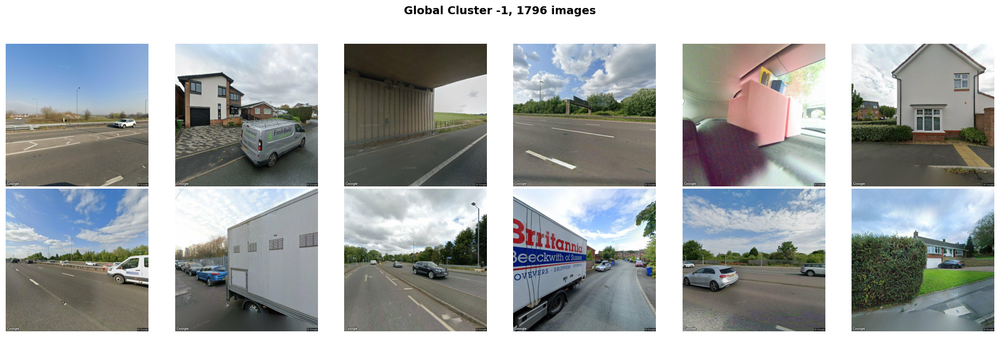

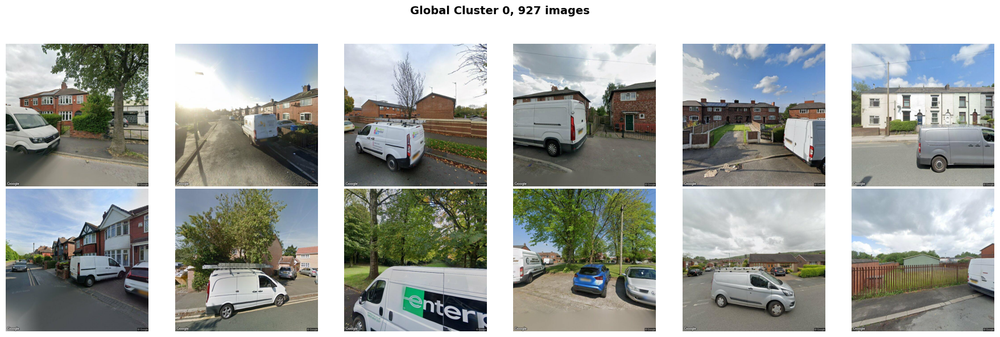

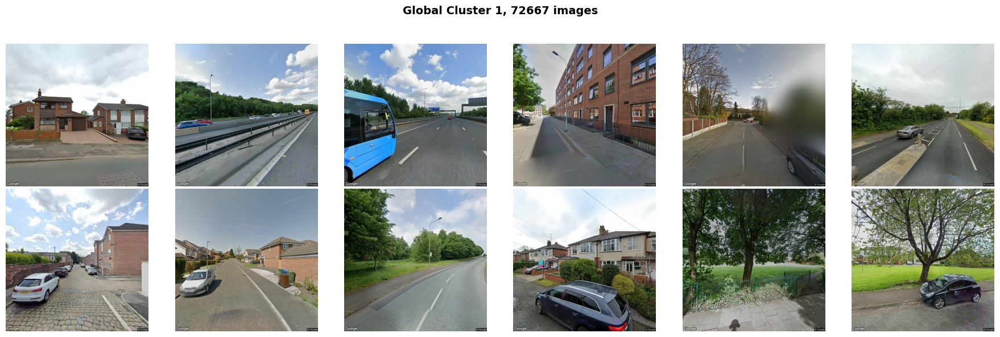

In [274]:
plot_example_images_per_cluster(expanded_gdf, k, "hdbscan", n_show=12)

In [187]:
all_embeddings = np.stack(expanded_gdf['embeddings'].values)
X = all_embeddings

umap_model = umap.UMAP(
    n_neighbors=50,   # smaller → preserves local structure → more clusters
    n_components=2,  # more dimensions → preserves small clusters
    min_dist=0.1,     # tight packing → clearer density
    metric='cosine',  # better for embeddings
    random_state=42)

X_umap = umap_model.fit_transform(X)

clusterer = hdbscan.HDBSCAN(
    min_cluster_size=100,   # smaller → more clusters
    min_samples=2,         # less strict → less noise
    cluster_selection_method='eom',  # use leaf clusters → finer structure
    metric='euclidean')
labels = clusterer.fit_predict(X_umap)
print(np.unique(labels, return_counts=True))
print(len(np.unique(labels)))

expanded_gdf['hdbscan_initial'] = labels
expanded_gdf = expanded_gdf[expanded_gdf['hdbscan_initial']!=0]

n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


(array([-1,  0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15,
       16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32,
       33, 34, 35, 36]), array([55398,   186,   369,   117,   209,   505,   290,   192,   771,
         238,   115,   170,   163,   136,   583,   313,   824,   105,
         115,  1151,   519,  1237,  2871,   139,   192,   861,   253,
         565,   158,   689,   103,   552,   342,   394,   124,   472,
        1052,  3103]))
38


In [209]:
expanded_gdf = pd.merge(left=expanded_gdf, right=imd, on="LSOA21CD")

### Check images to see whether clustering is logical (to me)

In [108]:
# plot_example_images_per_cluster(expanded_gdf, k, "scene_cluster8", n_show=24)

In [208]:
# plot_example_images_per_cluster(expanded_gdf, k, "hdbscan_initial", n_show=6)

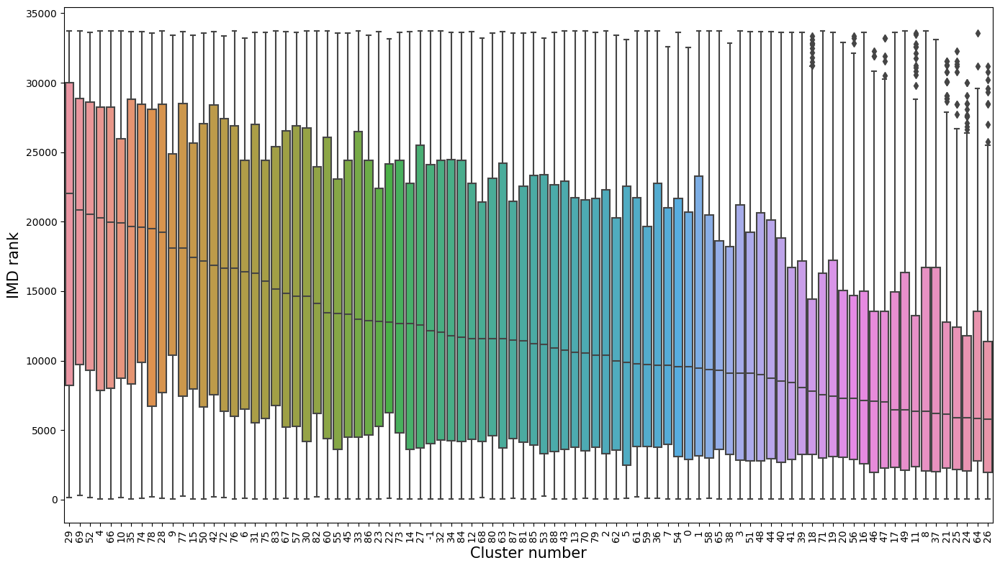

In [210]:
# Compute median IMD rank for each cluster
cluster_medians = (
    expanded_gdf.groupby('hdbscan')['imd_rank']
    .median()
    .sort_values(ascending=False))

# Extract the ordered cluster labels
ordered_clusters = cluster_medians.index.tolist()

plt.figure(figsize=(14, 8))
sns.boxplot(
    x='hdbscan',
    y='imd_rank',
    data=expanded_gdf,
    order=ordered_clusters)
plt.xticks(rotation=90)
plt.ylabel('IMD rank', fontsize=15)
plt.xlabel('Cluster number', fontsize=15)
plt.tight_layout()
plt.show()


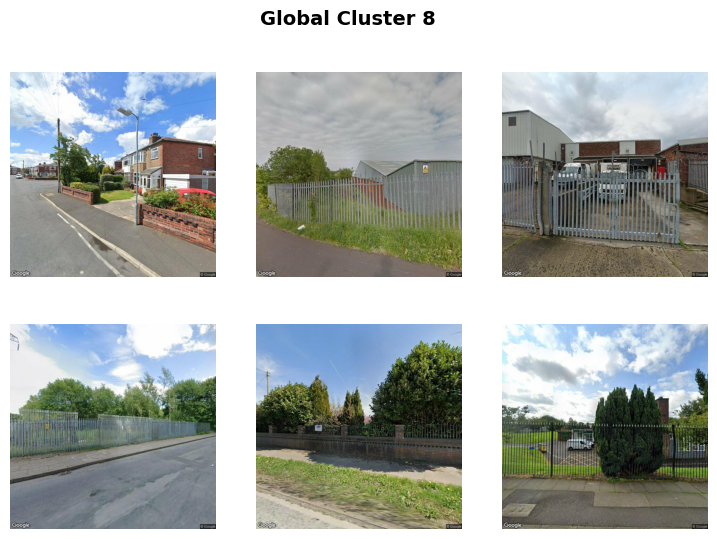

In [270]:
c=8
n_show=6
df = expanded_gdf
column = "hdbscan"
cluster_imgs = df.loc[df[column] == c, 'image_files']
fixed_rows, fixed_cols = int(n_show/3), 3  # always 6 spaces total
    
# Sample up to n_show images
sample_imgs = random.sample(list(cluster_imgs), min(n_show, len(cluster_imgs)))

fig, axes = plt.subplots(fixed_rows, fixed_cols, figsize=(fixed_cols * 3, fixed_rows * 3))
axes = np.array(axes).reshape(-1)  # flatten axes for easy indexing

for ax, img_path in zip(axes, sample_imgs):

    try:
        #adj_path = img_path.replace("../data/airbnb-manchester/street_images/", "../../data/embeddings/saliency_heatmaps_new/").replace("_new/point", "_new/attn_point")
        #adj_path = adj_path.replace(".jpg", ".jpg.png")
        adj_path = img_path.replace("airbnb-manchester/", "embeddings/").replace("../", "../../")
        img = plt.imread(adj_path)
        ax.imshow(img)
        ax.axis("off")
    except:
        print("image not found")
        
    plt.suptitle(f"Global Cluster {c}", fontsize=14, fontweight='bold')

In [128]:
# Count rows per LSOA and cluster
counts = (
    expanded_gdf
    .groupby(["LSOA21CD", "scene_cluster8"])
    .size()
    .reset_index(name="count"))

# Pivot wider so clusters become columns
pivot = counts.pivot(index="LSOA21CD", columns="scene_cluster8", values="count").fillna(0)

# Convert counts to percentages (row-wise)
percentages = pivot.div(pivot.sum(axis=1), axis=0) * 100

# Optionally rename columns for clarity
percentages.columns = [f"cluster_{int(c)}_pct" for c in percentages.columns]

percentages = percentages.reset_index()

percentages = pd.merge(left=percentages, right=imd[['LSOA21CD', 'imd_rank']], on="LSOA21CD")

In [57]:
# corr(percentages['imd_rank'], percentages['cluster_0_pct'])
percentages.corr()['imd_rank'].sort_values()


The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.


cluster_1_pct   -0.362020
cluster_0_pct   -0.173080
cluster_5_pct   -0.080748
cluster_2_pct   -0.021915
cluster_7_pct    0.051365
cluster_6_pct    0.101256
cluster_4_pct    0.264159
cluster_3_pct    0.288406
imd_rank         1.000000
Name: imd_rank, dtype: float64

In [90]:
import scipy.stats as stats
for k in range (0,8):
    print(stats.spearmanr(percentages[f'cluster_{k}_pct'], percentages['imd_rank']))


SignificanceResult(statistic=-0.27296994063865443, pvalue=2.4040755344874512e-30)
SignificanceResult(statistic=-0.39432927829434583, pvalue=3.621088297967345e-64)
SignificanceResult(statistic=-0.025284895632055066, pvalue=0.2981601028593604)
SignificanceResult(statistic=0.30015274343233095, pvalue=1.2564871283856187e-36)
SignificanceResult(statistic=0.21306615179524177, pvalue=7.476998864556453e-19)
SignificanceResult(statistic=-0.09856686054721936, pvalue=4.8044205301228765e-05)
SignificanceResult(statistic=0.0963814365341695, pvalue=7.056035379195713e-05)
SignificanceResult(statistic=0.06107642391009478, pvalue=0.01190213847124238)


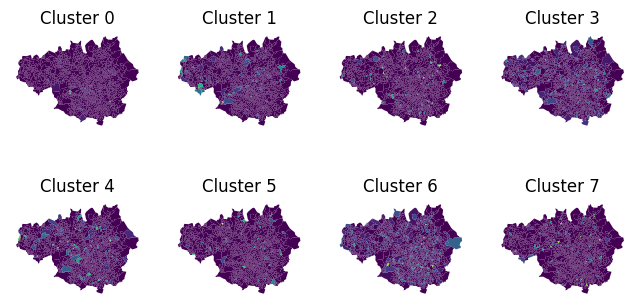

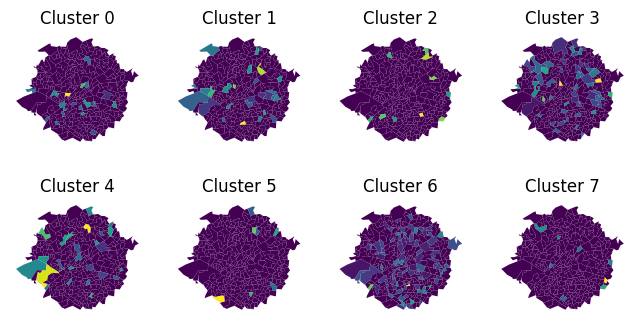

In [129]:
fig,axs=plt.subplots(ncols=4, nrows=2, figsize=(8,4), sharey=True, sharex=True)
axs=axs.flatten()
for i in range(0,8):

    lsoas_with_clusters = gm_lsoa.merge(percentages, on="LSOA21CD", how="left")

    # Fill any missing percentage values with 0 (e.g., if some LSOAs had no rows in expanded_gdf)
    lsoas_with_clusters = lsoas_with_clusters.fillna(0)

    lsoas_with_clusters.plot(f'cluster_{i}_pct', ax=axs[i])
    axs[i].set_title(f"Cluster {i}")
    axs[i].axis("off")
    
fig,axs=plt.subplots(ncols=4, nrows=2, figsize=(8,4), sharey=True, sharex=True)
axs=axs.flatten()
for i in range(0,8):

    lsoas_with_clusters = central_lsoas.merge(percentages, on="LSOA21CD", how="left")

    # Fill any missing percentage values with 0 (e.g., if some LSOAs had no rows in expanded_gdf)
    lsoas_with_clusters = lsoas_with_clusters.fillna(0)

    lsoas_with_clusters.plot(f'cluster_{i}_pct', ax=axs[i])
    axs[i].set_title(f"Cluster {i}")    
    axs[i].axis("off")

### For each LSOA, compare between and within cluster group similarity

In [16]:
lsoa_sim_df = lsoa_within_between_summary(expanded_gdf)
lsoa_sim_df.head()

,LSOA11CD,mean_within,mean_between,within_minus_between,n_images
0,E01004766,0.569487,0.357428,0.212058,64
1,E01004767,0.513547,0.328592,0.184955,72
2,E01004768,0.628970,0.389832,0.239138,56
3,E01004769,0.462095,0.293362,0.168733,36
4,E01004770,0.579001,0.351007,0.227994,40


### For each LSOA, calculate mean embedding in each cluster

In [31]:
K = expanded_gdf['scene_cluster'].max() + 1  # number of clusters
lsoa_cluster_means_df = mean_embedding_per_cluster(expanded_gdf, K, 'embedding_reduced')
lsoa_cluster_weighted_means_df = weighted_mean_embedding_per_cluster(expanded_gdf, 5, 'embedding')

In [18]:
lsoa_cluster_weighted_means_df = cluster_embeddings_with_proportions(expanded_gdf, 5, 'embedding')
embedding_dim = 768
X_ml = flatten_weighted_cluster_features(lsoa_cluster_weighted_means_df, K=5, embedding_dim=embedding_dim)

In [25]:
# Assume df_lsoa_features is output of cluster_embeddings_with_proportions
embedding_dim = 768
X_ml = flatten_weighted_cluster_features(lsoa_cluster_weighted_means_df, K=5, embedding_dim=embedding_dim)

In [20]:
X_ml.to_pickle(data_dir + "xml.pkl")

In [33]:
lsoa_cluster_means_df.to_pickle(data_dir + "global_clusters_mean_embeddings.pkl")
lsoa_cluster_weighted_means_df.to_pickle(data_dir + "global_clusters_weighted_mean_embeddings.pkl")

### Keep only LSOAs where no cluster embedding is missing

In [22]:
# cluster_cols = [f'cluster_{k}' for k in range(K)]
# complete_lsoas_df = lsoa_cluster_means_df.dropna(subset=cluster_cols)

# print(f"Kept {len(complete_lsoas_df)} LSOAs out of {len(lsoa_cluster_means_df)} that have all clusters present")

In [23]:
lsoa_cluster_means_df.to_pickle(data_dir + "global_clusters_mean_embeddings.pkl")